In [1]:
#
#  CNN-based scene recognition using Laplacian Eigenmaps
#   Please see https://qiita.com/TomHortons/items/2064870af3f3f7f2b209
#   for low-dimensional mappings
#

from keras.layers import Input, Dense, Flatten
from keras.models import Model, Sequential
from keras.applications.vgg19 import VGG19
import sys, glob, math, os
import cv2
import numpy as np
import re

Using TensorFlow backend.


In [2]:
# image sizes
img_rows, img_cols = 224, 224

In [3]:
def vgg19_lower_model():
    # initial model, load vgg19
    vgg19 = VGG19(include_top=True, weights='imagenet', input_tensor=None, input_shape=None)
    vgg19.summary()

    # new model that takes first 10 layers of VGG19
    model = Sequential()
    model.add(vgg19.get_layer('input_1'))
    model.add(vgg19.get_layer('block1_conv1'))
    model.add(vgg19.get_layer('block1_conv2'))
    model.add(vgg19.get_layer('block1_pool'))
    model.add(vgg19.get_layer('block2_conv1'))
    model.add(vgg19.get_layer('block2_conv2'))
    model.add(vgg19.get_layer('block2_pool'))
    model.add(vgg19.get_layer('block3_conv1'))
    model.add(vgg19.get_layer('block3_conv2'))
    model.add(vgg19.get_layer('block3_conv3'))
    model.add(vgg19.get_layer('block3_conv4'))
    model.add(vgg19.get_layer('block3_pool'))
    model.add(vgg19.get_layer('block4_conv1'))
    model.add(vgg19.get_layer('block4_conv2'))
    model.add(vgg19.get_layer('block4_conv3'))
    model.add(vgg19.get_layer('block4_conv4'))
    model.add(vgg19.get_layer('block4_pool'))
    model.add(vgg19.get_layer('block5_conv1'))
    model.add(vgg19.get_layer('block5_conv2'))
    model.add(vgg19.get_layer('block5_conv3'))
    model.add(vgg19.get_layer('block5_conv4'))
    model.summary()
 
    return model
#END vgg19_lower_model()

In [4]:
def load_imgs(dir,normalize=0):
    # load image data from dir

    data = []
    fname = []
    path  = dir + '/scene*.JPG'
    files = sorted(glob.glob(path))

    print('reading ')
    
    for fl in files:
        flbase = os.path.basename(fl)
        print('.',end='')

        img = cv2.imread(fl)
        img = cv2.resize(img, (img_rows,img_cols))
        img = np.array(img, dtype=np.float32)
        if normalize == 1:
            img -= np.mean(img)
            img /= np.std(img)

        data.append(img)
        fname.append(fl)

    data = np.array(data,dtype=np.float32)

    return data, fname
# end of load_imgs

In [5]:
def get_id_from_fname(str):
    
    m = re.match(r"([a-z/\\]+)([0-9]+)([a-z]+).[a-zA-Z]",str)

    if m:
    #    print("found!")
        id = int(m.group(2))
    #    print(id)
    else:
    #    print("not found!")
        id = -1
    
    return id
#end of get_id_from_frame

In [6]:
def angular_distance(vec1,vec2):
    v1 = vec1 / np.linalg.norm(vec1)
    v2 = vec2 / np.linalg.norm(vec2)
    
    return np.dot(v1,v2)
#end of angular_distance

In [7]:
def bhatta ( hist1,  hist2):
    # calculate mean of hist1
    h1_ = np.mean(hist1);

    # calculate mean of hist2
    h2_ = np.mean(hist2);

    # calculate score
    score = 0;
    for i in range(hist1.shape[0]):
        score = score + np.sqrt( hist1[i] * hist2[i] );
    # print h1_,h2_,score;
    score = np.sqrt( 1 - ( 1 / np.sqrt(h1_*h2_*hist1.shape[0]*hist1.shape[0]) ) * score );
    return score;

In [8]:
#if __name__=='__main__':
#    argv = sys.argv
#
#    if len(argv) < 2:
#        print('usage: %s [dir]' % argv[0])
#        exit(0)

data,fname = load_imgs('scenes',1) 

reading 
.........................................................................................................................................................................................................

In [9]:
print(data.shape)
#print(np.size(data2))
model = vgg19_lower_model()
out = model.predict(data, batch_size=32, verbose=1)
#cv2.waitKey(0)

print(out.shape)

(201, 224, 224, 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0 

In [10]:
id = []

for i in range(0,len(fname)):
#    f.write(fname[i]+'\n')
    r = get_id_from_fname(fname[i])
    if r:
        id.append(r)
    else:
        print("cannot retrieve id from" + format(fname[i]))
    
#f.close() 

In [11]:
print(id)
data = np.reshape(out,(out.shape[0],out.shape[1]*out.shape[2],out.shape[3]))

[7, 7, 7, 7, 7, 7, 7, 8, 8, 9, 9, 9, 9, 9, 9, 10, 10, 10, 10, 11, 11, 11, 12, 12, 12, 12, 13, 13, 13, 13, 14, 14, 14, 14, 15, 15, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17, 17, 17, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 20, 20, 20, 20, 21, 21, 21, 21, 21, 21, 21, 22, 22, 22, 22, 22, 23, 23, 23, 23, 23, 23, 23, 24, 24, 24, 24, 24, 24, 25, 25, 25, 25, 26, 26, 26, 26, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 28, 28, 28, 28, 28, 29, 29, 29, 30, 31, 31, 31, 31, 32, 32, 32, 32, 32, 32, 33, 33, 33, 33, 34, 34, 34, 34, 34, 34, 34, 35, 35, 35, 35, 36, 36, 36, 36, 37, 38, 38, 38, 38, 39, 39, 39, 39, 40, 40, 40, 41, 41, 41, 41, 41, 42, 42, 42, 42, 43, 43, 43, 43, 44, 44, 44, 44, 44, 44, 45, 45, 45, 46, 46, 46, 47, 47, 47, 48, 48, 48, 48, 49, 49, 49, 49]


In [12]:
data_all = np.reshape(out,(out.shape[0]*out.shape[1]*out.shape[2],out.shape[3]))
print(data_all.shape)

from sklearn.cluster import KMeans

NCLUSTER = 50

# kmeans clustering
kmeans_model = KMeans(n_clusters=NCLUSTER, random_state=10).fit(data_all)
pred = kmeans_model.labels_
print(pred)

(39396, 512)
[37 18 18 ...,  4  4  4]


cluster 0: 578
cluster 1: 825
cluster 2: 994
cluster 3: 1055
cluster 4: 1111
cluster 5: 1277
cluster 6: 598
cluster 7: 728
cluster 8: 579
cluster 9: 1286
cluster 10: 1148
cluster 11: 1156
cluster 12: 500
cluster 13: 638
cluster 14: 1004
cluster 15: 411
cluster 16: 1259
cluster 17: 1071
cluster 18: 797
cluster 19: 598
cluster 20: 307
cluster 21: 360
cluster 22: 317
cluster 23: 324
cluster 24: 1456
cluster 25: 1224
cluster 26: 1356
cluster 27: 649
cluster 28: 1350
cluster 29: 623
cluster 30: 734
cluster 31: 693
cluster 32: 520
cluster 33: 413
cluster 34: 831
cluster 35: 331
cluster 36: 293
cluster 37: 864
cluster 38: 277
cluster 39: 532
cluster 40: 531
cluster 41: 275
cluster 42: 1740
cluster 43: 529
cluster 44: 1234
cluster 45: 494
cluster 46: 171
cluster 47: 1060
cluster 48: 1961
cluster 49: 334


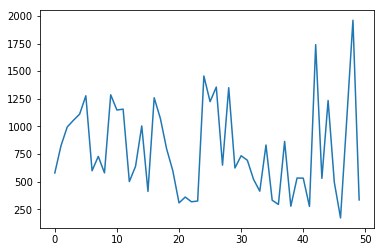

In [13]:
freq = np.zeros(NCLUSTER)

for i in range(0,pred.shape[0]):
    freq[pred[i]] = freq[pred[i]] + 1

ccolor = []
    
for i in range(0,50):
    print('cluster %d: %d'%(i,freq[i]))
    if freq[i] > 1000:
        ccolor.append((255,0,0))
    elif freq[i] > 600:
        ccolor.append((0,255,0))
    else:
        ccolor.append((0,0,255))
    
import matplotlib.pyplot as plt

plt.plot(freq)
plt.show()

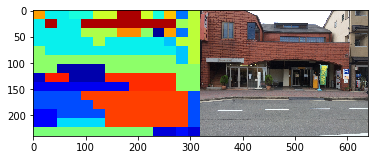

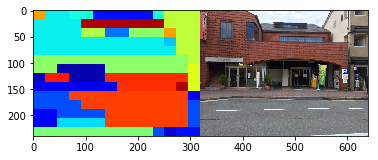

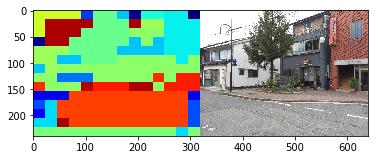

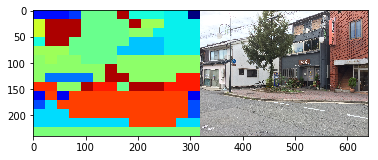

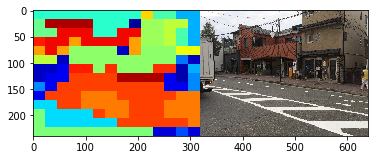

...

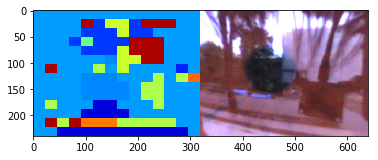

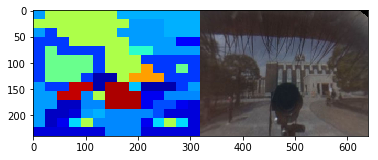

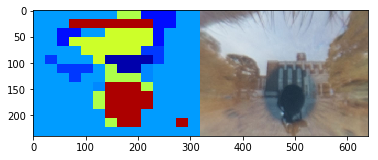

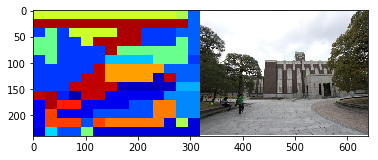

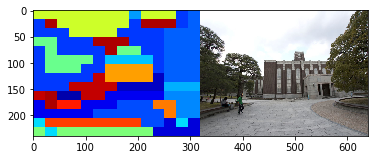

In [14]:
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# マンガ効果
# plt.xkcd()   

# Colorlize by occurance
for i in range(0,out.shape[0]):
    img = Image.new('RGB', (out.shape[1], out.shape[2]), (0, 0, 0))
    
    for y in range(0,out.shape[1]):
        idx = kmeans_model.predict(out[i,y,:,:])
#        print(idx)
        for x in range(0,out.shape[2]):
            # map idx to color by JeT
            tmp = 255*np.array(cm.jet(idx[x]/50.0)[0:3])
            ctmp = tuple(map(int, tmp))
            img.putpixel((x,y),ctmp)

    img = img.resize((320,240))
    img2 = Image.open(fname[i],'r')
    img2 = img2.resize(img.size)

    plt.imshow(np.hstack((np.array(img),np.array(img2))))
    plt.show()
    

In [21]:
# read csv file with name and class
import csv

f = open('result-frame-org.csv', newline='')
reader = csv.reader(f, delimiter=',', quoting=csv.QUOTE_NONE)
gt_name = []
gt_label = []
for row in reader:
    if row:    # checking for empty line
        gt_name.append(row[0])
        gt_label.append(row[1])

gt_label = np.array(gt_label)
#gt_label = np.loadtxt("result-frame-org.csv",delimiter=",", usecols=(1))

In [22]:
# Histogram-based matching

hist = np.zeros((out.shape[0],NCLUSTER))

for i in range(0,out.shape[0]):
    img = Image.new('RGB', (out.shape[1], out.shape[2]), (0, 0, 0))
    
    for y in range(0,out.shape[1]):
        val = kmeans_model.predict(out[i,y,:,:])
        for x in range(0,val.shape[0]):
            hist[i][val[x]] = hist[i][val[x]] + 1

d = np.zeros((out.shape[0],out.shape[0]))
n = 0

for i in range(0,out.shape[0]):
    for j in range(0,out.shape[0]):
        d[i,j] = bhatta( hist[i], hist[j])

    idx = np.argsort(d[i,:])
#    idx = idx[-1::-1]

    if gt_label[i] == gt_label[idx[1]]:
        print('o: %d(%s) %d(%s) %d(%s) : %f'%(i, gt_name[i], idx[0], gt_name[idx[0]], idx[1], gt_name[idx[1]], d[idx[0],idx[1]]))
        n = n + 1
    else:
        print('x: %d(%s) %d(%s) %d(%s) %d(%s): %f'%(i, gt_name[i], idx[0], gt_name[idx[0]], idx[1], gt_name[idx[1]], idx[2], gt_name[idx[2]], d[idx[0],idx[1]]))
#        when show images
#        dir = 'scenes\\'
#        im1 = Image.open('%s%s'%(dir,gt_name[idx[0]]),'r')
#        im1 = im1.resize((320,240))
#        im2 = Image.open('%s%s'%(dir,gt_name[idx[1]]),'r')
#        im2 = im2.resize(im1.size)
#        plt.imshow(np.hstack((np.array(im1),np.array(im2))))
#        plt.show()

print('Correct : %d / %d (%f)'%(n,out.shape[0],n/out.shape[0]))

o: 0(scene007a.JPG) 0(scene007a.JPG) 1(scene007b.JPG) : 0.205935
o: 1(scene007b.JPG) 1(scene007b.JPG) 0(scene007a.JPG) : 0.205935
o: 2(scene007c.JPG) 2(scene007c.JPG) 3(scene007d.JPG) : 0.166320
o: 3(scene007d.JPG) 3(scene007d.JPG) 2(scene007c.JPG) : 0.166320
x: 4(scene007e.JPG) 4(scene007e.JPG) 7(scene008a.JPG) 165(scene041a.JPG): 0.449431
o: 5(scene007f.JPG) 5(scene007f.JPG) 6(scene007g.JPG) : 0.157999
o: 6(scene007g.JPG) 6(scene007g.JPG) 5(scene007f.JPG) : 0.157999
x: 7(scene008a.JPG) 7(scene008a.JPG) 172(scene042c.JPG) 4(scene007e.JPG): 0.403802
x: 8(scene008b.JPG) 8(scene008b.JPG) 76(scene022e.JPG) 7(scene008a.JPG): 0.566054
o: 9(scene009a.JPG) 9(scene009a.JPG) 10(scene009b.JPG) : 0.148231
o: 10(scene009b.JPG) 10(scene009b.JPG) 9(scene009a.JPG) : 0.148231
o: 11(scene009c.JPG) 11(scene009c.JPG) 12(scene009d.JPG) : 0.141599
o: 12(scene009d.JPG) 12(scene009d.JPG) 11(scene009c.JPG) : 0.141599
o: 13(scene009e.JPG) 13(scene009e.JPG) 14(scene009f.JPG) : 0.235150
o: 14(scene009f.JPG) 14(s

o: 122(scene029c.JPG) 122(scene029c.JPG) 121(scene029b.JPG) : 0.271779
x: 123(scene030a.JPG) 123(scene030a.JPG) 134(scene033a.JPG) 43(scene016e.JPG): 0.470617
x: 124(scene031a.JPG) 124(scene031a.JPG) 121(scene029b.JPG) 74(scene022c.JPG): 0.474863
o: 125(scene031b.JPG) 125(scene031b.JPG) 126(scene031c.JPG) : 0.280571
o: 126(scene031c.JPG) 126(scene031c.JPG) 125(scene031b.JPG) : 0.280571
o: 127(scene031d.JPG) 127(scene031d.JPG) 126(scene031c.JPG) : 0.575271
o: 128(scene032a.JPG) 128(scene032a.JPG) 129(scene032b.JPG) : 0.454228
o: 129(scene032b.JPG) 129(scene032b.JPG) 130(scene032c.JPG) : 0.172968
o: 130(scene032c.JPG) 130(scene032c.JPG) 129(scene032b.JPG) : 0.172968
x: 131(scene032d.JPG) 131(scene032d.JPG) 63(scene020c.JPG) 132(scene032e.JPG): 0.449547
o: 132(scene032e.JPG) 132(scene032e.JPG) 130(scene032c.JPG) : 0.413501
o: 133(scene032fa.JPG) 133(scene032fa.JPG) 130(scene032c.JPG) : 0.483693
x: 134(scene033a.JPG) 134(scene033a.JPG) 123(scene030a.JPG) 136(scene033c.JPG): 0.470617
o: 135

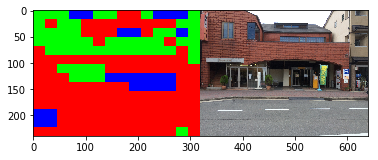

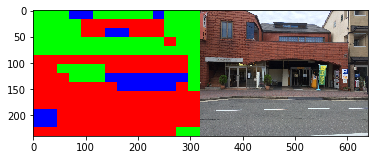

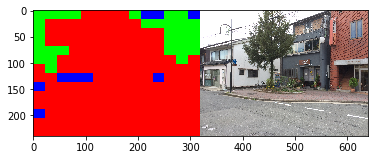

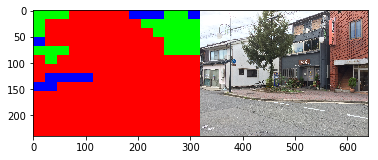

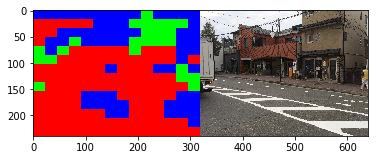

...

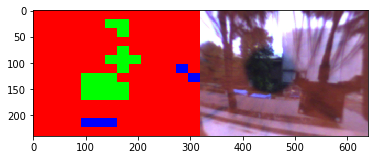

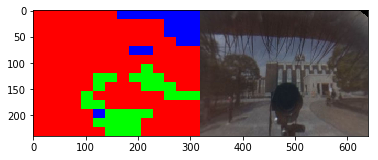

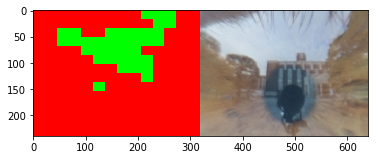

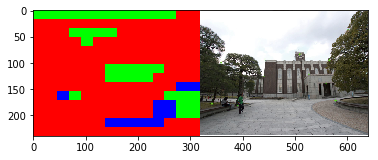

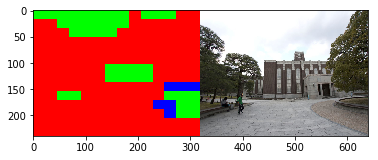

In [24]:
from PIL import Image
import matplotlib.pyplot as plt

# マンガ効果
# plt.xkcd()   

# Colorlize by occurance
for i in range(0,out.shape[0]):
    img = Image.new('RGB', (out.shape[1], out.shape[2]), (0, 0, 0))
    
    for y in range(0,out.shape[1]):
        idx = kmeans_model.predict(out[i,y,:,:])
#        print(idx)
        for x in range(0,out.shape[2]):
            img.putpixel((x,y),ccolor[idx[x]])

    img = img.resize((320,240))
    img2 = Image.open(fname[i],'r')
    img2 = img2.resize(img.size)

    plt.imshow(np.hstack((np.array(img),np.array(img2))))
    plt.show()
    

In [19]:
import matplotlib.cm as cm

tmp = np.array(cm.jet(idx[5]/50.0)[0:3])
tmp = tmp * 255

print(list(map(int, tmp)))

[124, 255, 121]
